This is a notebook to analyze the predictions of our NN ensemble for one experiment/scenarios (control, historical, ssp585). By using our NN ensemble, we can quickly see the predicted dynamical regimes for each scenario and identify regions of interest.

In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 

import numpy as np
import matplotlib.path as mpath
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap, ListedColormap, to_rgba
import matplotlib.ticker as mticker
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature

from sklearn.preprocessing import StandardScaler
from sklearn.metrics import ConfusionMatrixDisplay

import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Reshape, Flatten, Input, Dropout, BatchNormalization, Concatenate
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow import keras 

from pickle import dump, load

In [2]:
experiment = 'ssp585_2080_2099'

missingdataindex = np.load(f'Data_Step2/{experiment}/missingdataindex.npy')
maskTraining = np.load(f'Data_Step2/{experiment}/maskTraining.npy')
maskVal = np.load(f'Data_Step2/{experiment}/maskVal.npy')
maskTest = np.load(f'Data_Step2/{experiment}/maskTest.npy')

num_clusters = 6

total_features = np.load(f'Data_Step2/{experiment}/total_features.npy')
train_features = np.load(f'Data_Step2/{experiment}/train_features.npy')
val_features = np.load(f'Data_Step2/{experiment}/val_features.npy')
test_features = np.load(f'Data_Step2/{experiment}/test_features.npy')

In [3]:
scaler = load(open(f'Data_Step2/control/scaler.pkl', 'rb'))
scaler.mean_, scaler.scale_

(array([-2.85953411e-11,  3.68473248e+03, -2.93517822e-01, -1.78395655e-05,
         7.85527389e-05,  2.14230237e-03,  4.95123948e-07,  6.49555247e-07,
         3.01111445e+08, -1.45646523e+07]),
 array([1.86685043e-10, 1.61048766e+03, 7.99068436e-01, 1.03240757e-04,
        6.63678833e-01, 4.30530589e-02, 1.86624197e-05, 2.45397653e-06,
        1.35950753e+09, 9.36660921e+08]))

In [4]:
X_total_scaled = scaler.transform(total_features)
X_train_scaled = scaler.transform(train_features)
X_val_scaled = scaler.transform(val_features)
X_test_scaled = scaler.transform(test_features)

X_train_scaled.shape

(481049, 10)

In [5]:
model_name = f'model_24x2_16x2_tanh_{num_clusters}_clusters'
ensemble_size = 50

# Get the predictions of each ensemble member
prob_predictions = np.empty(shape=(ensemble_size, X_total_scaled.shape[0], num_clusters))
for i in range(ensemble_size):
    model = tf.keras.models.load_model(f'saved_models/{model_name}/model_{i}.h5')
    prob_predictions[i] = model(X_total_scaled).numpy()

prob_mean = prob_predictions.mean(axis = 0)

In [6]:
col_height = xr.open_dataset(f'Data_Step2/{experiment}/col_height.nc').rename({'yh':'lat', 'xh':'lon'})['col_height']

# Ensure that longitude coords are from -180 to 180
col_height.coords['lon'] = (col_height.coords['lon'] + 180) % 360 - 180
col_height = col_height.sortby(col_height.lon)

In [9]:
control_pred = xr.open_dataset(f'Data_Step2/control/{model_name}_ensemble_mean_pred.nc')['Model Pred']
control_entropy = xr.open_dataset(f'Data_Step2/control/entropy.nc')['Entropy']

In [8]:
pred = np.nan * np.zeros((1080,1440))
pred[~missingdataindex] = prob_mean.argmax(axis=1)
pred = xr.DataArray(data=pred,
                    dims=['lat','lon'],
                    coords=dict(lat=col_height['lat'], lon=col_height['lon']),
                    name='Model Pred')

'''
correct_idx = np.where(np.argmax(prob_mean, axis=1) == np.argmax(Y_total, axis=1), 1, 0)
tf_vals = np.nan * np.zeros((1080,1440))
tf_vals[~missingdataindex] = correct_idx
tf_vals = xr.DataArray(data=tf_vals,
                       dims=['lat','lon'],
                       coords=dict(lat=col_height['lat'], lon=col_height['lon']),
                       name='true-false')
'''

entropy_vals = -np.sum(prob_mean* np.log2(prob_mean), axis=1)
entropy = np.nan * np.zeros((1080,1440))
entropy[~missingdataindex] = entropy_vals
entropy = xr.DataArray(data=entropy,
                       dims=['lat','lon'],
                       coords=dict(lat=col_height['lat'], lon=col_height['lon']),
                       name='Entropy')

In [10]:
pred.to_netcdf(f'Data_Step2/{experiment}/{model_name}_ensemble_mean_pred.nc')

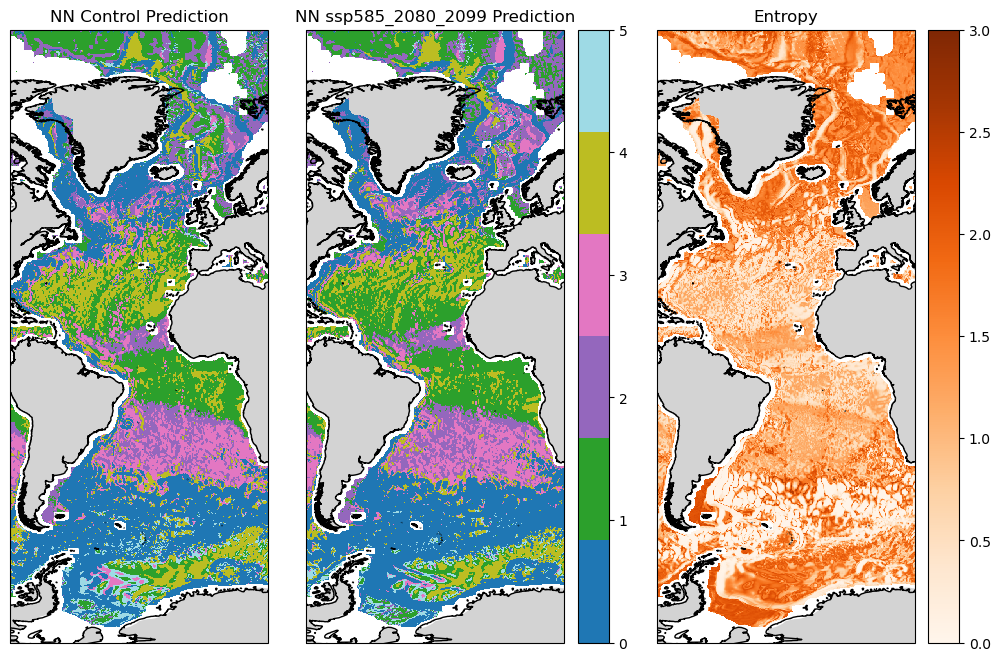

In [11]:
fig, axes = plt.subplots(1, 3, subplot_kw={'projection':ccrs.Miller()}, figsize=(10,6.5), constrained_layout=True)

control_pred.isel(lon=slice(400,800)).plot(ax=axes[0], transform=ccrs.PlateCarree(),
                                           cmap=plt.get_cmap('tab20', num_clusters), add_colorbar=False)

pred.isel(lon=slice(400,800)).plot(ax=axes[1], transform=ccrs.PlateCarree(),
                                   cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy.isel(lon=slice(400,800)).plot(ax=axes[2], transform=ccrs.PlateCarree(),
                                      cmap='Oranges', vmin=0, vmax=3, cbar_kwargs={'label':''})

axes[0].set_title('NN Control Prediction')
axes[0].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[0].coastlines(resolution='10m')

axes[1].set_title(f'NN {experiment} Prediction')
axes[1].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[1].coastlines(resolution='10m')

axes[2].set_title(f'Entropy')
axes[2].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[2].coastlines(resolution='10m')

plt.show()

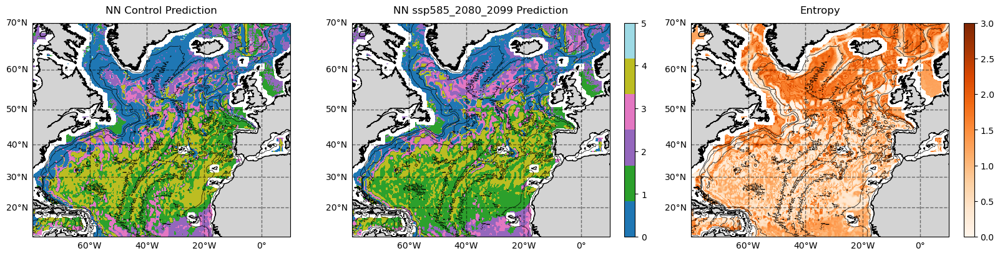

In [12]:
fig, axes = plt.subplots(1, 3, subplot_kw={'projection':ccrs.Miller()}, figsize=(16,4), constrained_layout=True)

control_pred.sel(lon=slice(-80,10)).sel(lat=slice(10,70)).plot(ax=axes[0], transform=ccrs.PlateCarree(),
                                                               cmap=plt.get_cmap('tab20', num_clusters), add_colorbar=False)

pred.sel(lon=slice(-80,10)).sel(lat=slice(10,70)).plot(ax=axes[1], transform=ccrs.PlateCarree(),
                                                       cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy.sel(lon=slice(-80,10)).sel(lat=slice(10,70)).plot(ax=axes[2], transform=ccrs.PlateCarree(),
                                                          cmap='Oranges', vmin=0, vmax=3, cbar_kwargs={'label':''})

for i in range(3):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(10,70)), ax=axes[i],
                    transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)
    gl = axes[i].gridlines(crs=ccrs.PlateCarree(), linewidth=1, color='black', alpha=0.5, linestyle='--', draw_labels=True)
    gl.top_labels = False
    gl.right_labels = False
    
axes[0].set_title('NN Control Prediction')
axes[1].set_title(f'NN {experiment} Prediction')
axes[2].set_title(f'Entropy')

#plt.savefig(f'figures/regime_shift/natlantic_{experiment}_regimes', dpi=600)
plt.show()

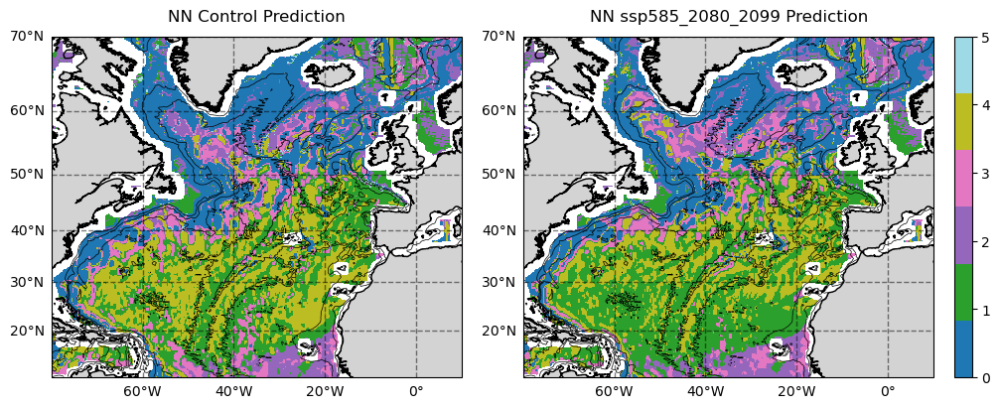

In [13]:
fig, axes = plt.subplots(1, 2, subplot_kw={'projection':ccrs.Miller()}, figsize=(10,4), constrained_layout=True)

control_pred.sel(lon=slice(-80,10)).sel(lat=slice(10,70)).plot(ax=axes[0], transform=ccrs.PlateCarree(),
                                                               cmap=plt.get_cmap('tab20', num_clusters), add_colorbar=False)

pred.sel(lon=slice(-80,10)).sel(lat=slice(10,70)).plot(ax=axes[1], transform=ccrs.PlateCarree(),
                                                       cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

for i in range(2):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(10,70)), ax=axes[i],
                    transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)
    gl = axes[i].gridlines(crs=ccrs.PlateCarree(), linewidth=1, color='black', alpha=0.5, linestyle='--', draw_labels=True)
    gl.top_labels = False
    gl.right_labels = False
    
axes[0].set_title('NN Control Prediction')
axes[1].set_title(f'NN {experiment} Prediction')

#plt.savefig(f'figures/regime_shift/natlantic_{experiment}_regimes', dpi=600)
plt.show()

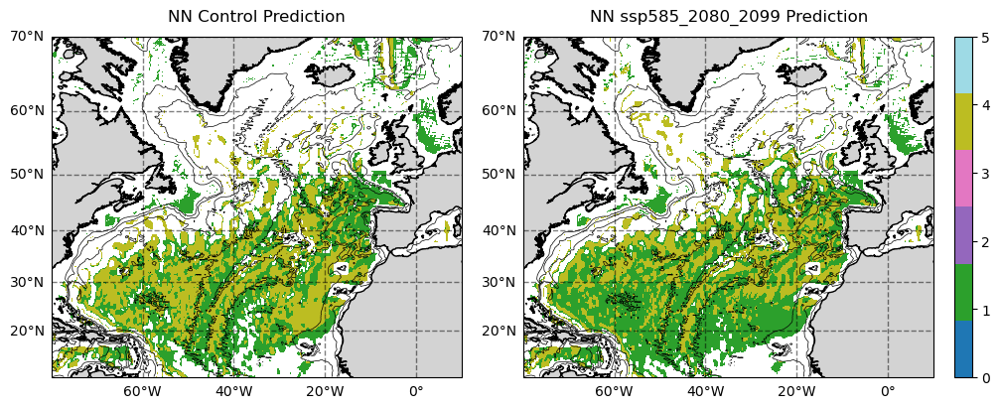

In [15]:
fig, axes = plt.subplots(1, 2, subplot_kw={'projection':ccrs.Miller()}, figsize=(10,4), constrained_layout=True)

to_plot = xr.where((control_pred == 1) | (control_pred == 4), control_pred, np.nan).sel(lon=slice(-80,10)).sel(lat=slice(10,70))
to_plot.plot(ax=axes[0], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
             vmin=0, vmax=num_clusters-1, add_colorbar=False)

to_plot = xr.where((pred == 1) | (pred == 4), pred, np.nan).sel(lon=slice(-80,10)).sel(lat=slice(10,70))

to_plot.plot(ax=axes[1], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
             vmin=0, vmax=num_clusters-1, cbar_kwargs={'label':''})

for i in range(2):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(10,70)), ax=axes[i],
                    transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)
    gl = axes[i].gridlines(crs=ccrs.PlateCarree(), linewidth=1, color='black', alpha=0.5, linestyle='--', draw_labels=True)
    gl.top_labels = False
    gl.right_labels = False
    
axes[0].set_title('NN Control Prediction')
axes[1].set_title(f'NN {experiment} Prediction')

#plt.savefig(f'figures/regime_shift/natlantic_{experiment}_regimes', dpi=600)
plt.show()

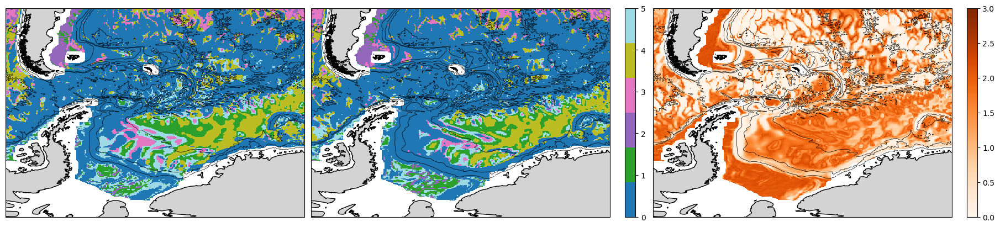

In [28]:
fig, axes = plt.subplots(1, 3, subplot_kw={'projection':ccrs.Miller()}, figsize=(18,4), constrained_layout=True)

control_pred.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)).plot(ax=axes[0], transform=ccrs.PlateCarree(),
                                                                 cmap=plt.get_cmap('tab20', num_clusters), add_colorbar=False)

pred.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)).plot(ax=axes[1], transform=ccrs.PlateCarree(),
                                                         cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)).plot(ax=axes[2], transform=ccrs.PlateCarree(),
                                                            cmap='Oranges', vmin=0, vmax=3, cbar_kwargs={'label':''})

axes[0].set_title('NN Control Prediction')
axes[1].set_title(f'NN {experiment} Prediction')
axes[2].set_title(f'Entropy')

for i in range(3):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)), ax=axes[i], 
                    transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)

plt.savefig(f'figures/regime_shift/socean_{experiment}_regimes', dpi=600)
plt.show()

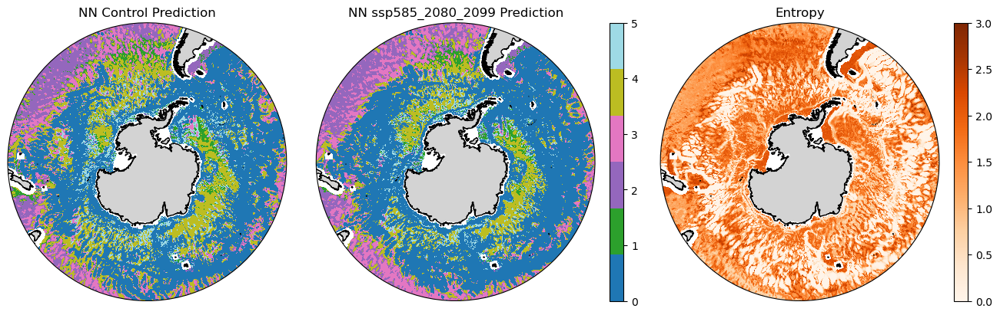

In [30]:
fig, axes = plt.subplots(1, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(13,4), constrained_layout=True)

control_pred.sel(lat=slice(-90,-40)).plot(ax=axes[0], transform=ccrs.PlateCarree(),
                                          cmap=plt.get_cmap('tab20', num_clusters), add_colorbar=False)

pred.sel(lat=slice(-90,-40)).plot(ax=axes[1], transform=ccrs.PlateCarree(),
                                  cmap=plt.get_cmap('tab20', num_clusters), cbar_kwargs={'label':''})

entropy.sel(lat=slice(-90,-40)).plot(ax=axes[2], transform=ccrs.PlateCarree(),
                                     cmap='Oranges', vmin=0, vmax=3, cbar_kwargs={'label':''})

axes[0].set_title('NN Control Prediction')
axes[1].set_title(f'NN {experiment} Prediction')
axes[2].set_title(f'Entropy')

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

for i in range(3):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    axes[i].set_boundary(circle, transform=axes[i].transAxes)
    #xr.plot.contour(col_height.sel(lat=slice(-90,-40)), ax=axes[i], transform=ccrs.PlateCarree(),
    #                colors='black', alpha=0.75, linewidths=0.5)

plt.savefig(f'figures/regime_shift/socean_full_{experiment}_regimes', dpi=600)
plt.show()

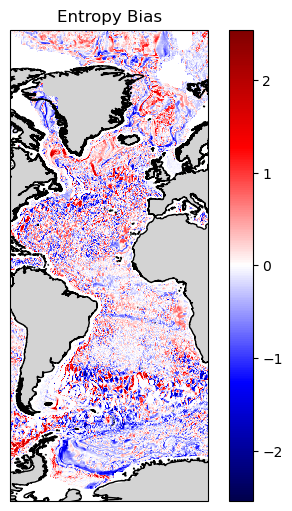

In [21]:
fig, axes = plt.subplots(1, 1, subplot_kw={'projection':ccrs.Miller()}, figsize=(5,5), constrained_layout=True)

(entropy-control_entropy).isel(lon=slice(400,800)).plot(ax=axes, transform=ccrs.PlateCarree(),
                                                        cmap='seismic', cbar_kwargs={'label':''})

axes.set_title(f'Entropy Bias')
axes.add_feature(cfeature.LAND, facecolor='lightgrey')
axes.coastlines(resolution='10m')

plt.show()

(array([6.18000e+02, 3.93000e+03, 1.99060e+04, 8.10420e+04, 3.70466e+05,
        2.78495e+05, 6.08830e+04, 1.52170e+04, 3.57700e+03, 2.84000e+02]),
 array([-2.50262019, -1.99849781, -1.49437542, -0.99025303, -0.48613064,
         0.01799175,  0.52211413,  1.02623652,  1.53035891,  2.0344813 ,
         2.53860369]),
 <BarContainer object of 10 artists>)

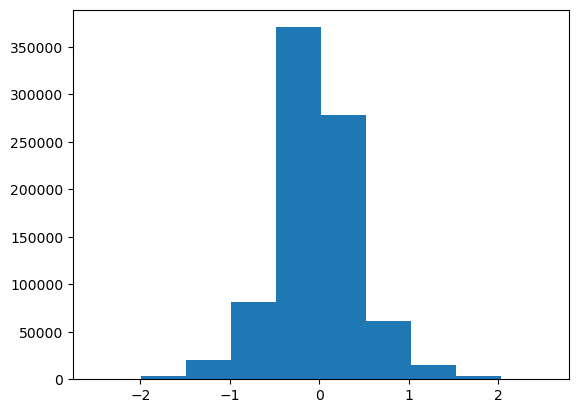

In [22]:
plt.hist((entropy-control_entropy).data.flatten())

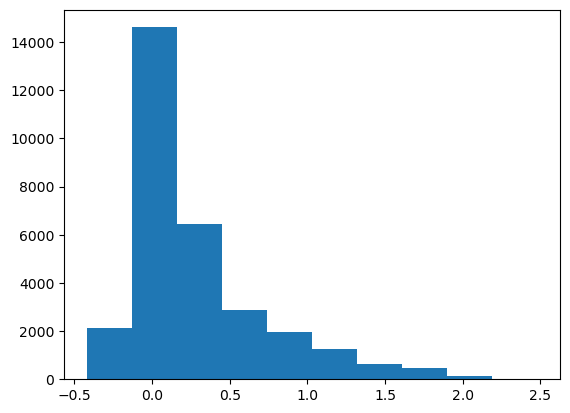

In [44]:
entropy_bias = entropy - control_entropy

test = xr.where(pred == 5, entropy_bias, np.nan).data.flatten()
test = test[~np.isnan(test)]

plt.hist(test)
plt.show()

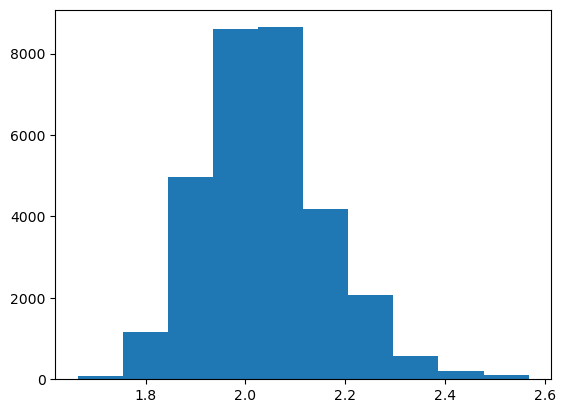

In [58]:
test = xr.where(pred == 5, entropy, np.nan).data.flatten()
test = test[~np.isnan(test)]

plt.hist(test)
plt.show()

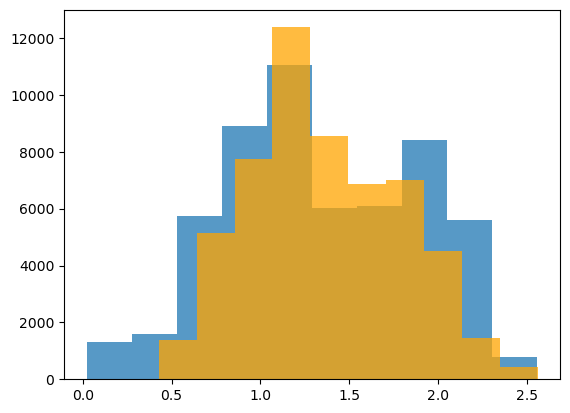

In [65]:
test = xr.where(pred == 4, control_entropy, np.nan).sel(lat=slice(-90,-40)).data.flatten()
test = test[~np.isnan(test)]

plt.hist(test, alpha=0.75)

test = xr.where(pred == 4, entropy, np.nan).sel(lat=slice(-90,-40)).data.flatten()
test = test[~np.isnan(test)]

plt.hist(test, color='orange', alpha=0.75)

plt.show()

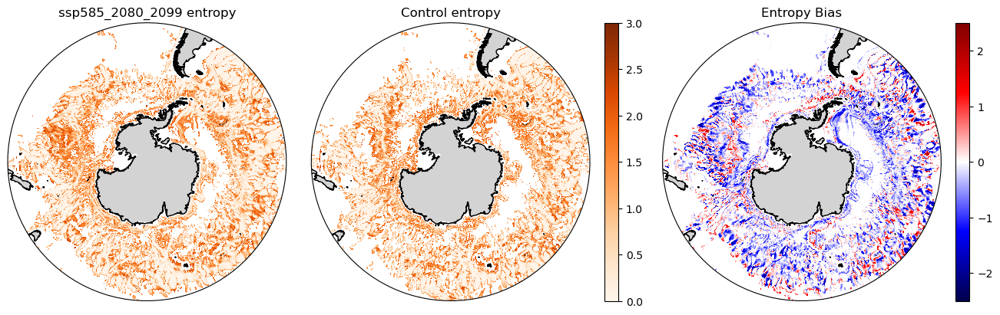

In [55]:
fig, axes = plt.subplots(1, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(13,4), constrained_layout=True)

regime = 0

to_plot = xr.where(pred == regime, entropy, np.nan).sel(lat=slice(-90,-40))
to_plot.plot(ax=axes[0], transform=ccrs.PlateCarree(), cmap='Oranges', 
                                     vmin=0, vmax=3, add_colorbar=False)

to_plot = xr.where(control_pred == regime, control_entropy, np.nan).sel(lat=slice(-90,-40))
to_plot.plot(ax=axes[1], transform=ccrs.PlateCarree(), cmap='Oranges',
                                             vmin=0, vmax=3, cbar_kwargs={'label':''})

to_plot = xr.where(pred == regime, entropy-control_entropy, np.nan).sel(lat=slice(-90,-40))
to_plot.plot(ax=axes[2], transform=ccrs.PlateCarree(),
                                                       cmap='seismic', cbar_kwargs={'label':''})

axes[0].set_title(f'{experiment} entropy')
axes[1].set_title('Control entropy')
axes[2].set_title('Entropy Bias')

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

for i in range(3):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    axes[i].set_boundary(circle, transform=axes[i].transAxes)

plt.show()

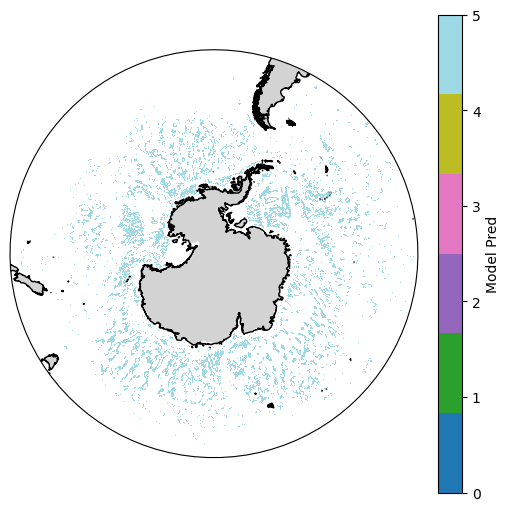

In [50]:
fig, axes = plt.subplots(1, 1, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(5,5), constrained_layout=True)

xr.where(control_pred == 5, control_pred, np.nan).sel(lat=slice(-90,-40)).plot(ax=axes, transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                                                            vmin=0, vmax=num_clusters-1)


# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

axes.add_feature(cfeature.LAND, facecolor='lightgrey')
axes.coastlines(resolution='10m')
axes.set_boundary(circle, transform=axes.transAxes)

plt.show()

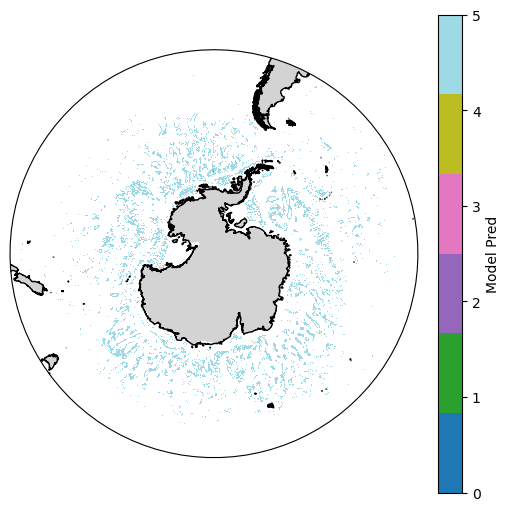

In [49]:
fig, axes = plt.subplots(1, 1, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(5,5), constrained_layout=True)

xr.where(pred == 5, pred, np.nan).sel(lat=slice(-90,-40)).plot(ax=axes, transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                                                            vmin=0, vmax=num_clusters-1)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

axes.add_feature(cfeature.LAND, facecolor='lightgrey')
axes.coastlines(resolution='10m')
axes.set_boundary(circle, transform=axes.transAxes)

plt.show()

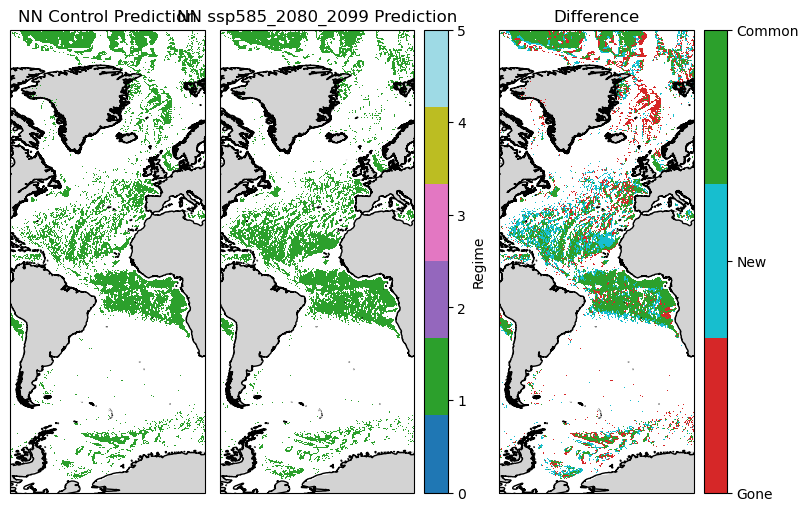

In [11]:
regime = 1

fig, axes = plt.subplots(1, 3, subplot_kw={'projection':ccrs.Miller()}, figsize=(8,5), constrained_layout=True)

regime_control = xr.where(control_pred == regime, regime, np.nan)
regime_control.isel(lon=slice(400,800)).plot(ax=axes[0], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                    add_colorbar=False, vmin=0, vmax=num_clusters-1)

regime_scenario = xr.where(pred == regime, regime, np.nan)
regime_scenario.isel(lon=slice(400,800)).plot(ax=axes[1], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                     cbar_kwargs={'label':'Regime'}, vmin=0, vmax=num_clusters-1)

difference = xr.where((regime_control == regime) & (regime_scenario == regime), 0, np.nan)
difference = xr.where((regime_scenario == regime) & np.isnan(regime_control), -1, difference)
difference = xr.where((regime_control == regime) & np.isnan(regime_scenario), -2, difference)

#tf_colors = np.array([to_rgba(color) for color in ListedColormap(['purple', 'green']).colors])
tf_colors = [[0.83921569, 0.15294118, 0.15686275, 1.        ],
             [0.09019608, 0.74509804, 0.81176471, 1.        ]]
regime_color = np.expand_dims(plt.get_cmap('tab20', num_clusters).colors[regime], axis=0)
new_cmap = ListedColormap(np.append(tf_colors, regime_color, axis=0))

pcm = difference.isel(lon=slice(400,800)).plot(ax=axes[2], transform=ccrs.PlateCarree(), cmap=new_cmap,
                                         vmin=-2, vmax=0, add_colorbar=False)
my_cbar = fig.colorbar(pcm, ax=axes[2], ticks=[-2,-1,0])
my_cbar.ax.set_yticklabels(['Gone', 'New', 'Common'])


axes[0].set_title('NN Control Prediction')
axes[0].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[0].coastlines(resolution='10m')

axes[1].set_title(f'NN {experiment} Prediction')
axes[1].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[1].coastlines(resolution='10m')

axes[2].set_title('Difference')
axes[2].add_feature(cfeature.LAND, facecolor='lightgrey')
axes[2].coastlines(resolution='10m')

plt.show()

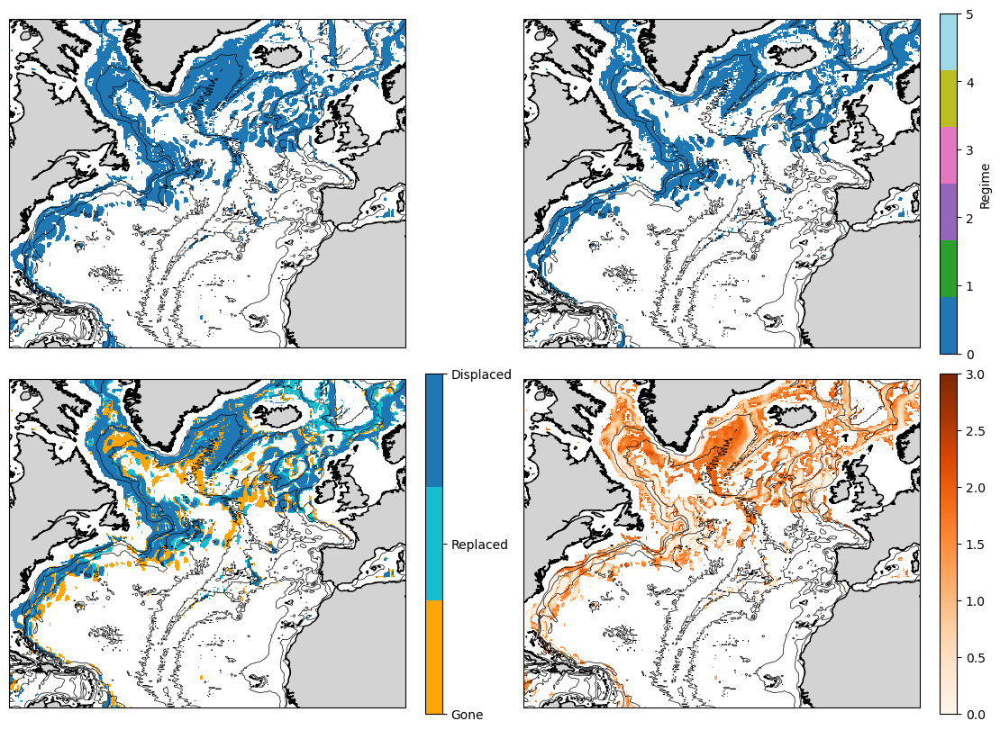

In [12]:
regime = 0

fig, axes = plt.subplots(2, 2, subplot_kw={'projection':ccrs.Miller()}, figsize=(11,8), constrained_layout=True)

regime_control = xr.where(control_pred == regime, regime, np.nan)
to_plot = regime_control.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
to_plot.plot(ax=axes[0,0], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
             add_colorbar=False, vmin=0, vmax=num_clusters-1)

regime_scenario = xr.where(pred == regime, regime, np.nan)
to_plot = regime_scenario.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
to_plot.plot(ax=axes[0,1], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
             cbar_kwargs={'label':'Regime'}, vmin=0, vmax=num_clusters-1)

difference = xr.where((regime_control == regime) & (regime_scenario == regime), 0, np.nan)
difference = xr.where((regime_scenario == regime) & np.isnan(regime_control), -1, difference)
difference = xr.where((regime_control == regime) & np.isnan(regime_scenario), -2, difference)

#tf_colors = np.array([to_rgba(color) for color in ListedColormap(['purple', 'green']).colors])
tf_colors = [[1.0, 0.6470588235294118, 0.0, 1.0],
             [0.09019608, 0.74509804, 0.81176471, 1.]]
regime_color = np.expand_dims(plt.get_cmap('tab20', num_clusters).colors[regime], axis=0)
new_cmap = ListedColormap(np.append(tf_colors, regime_color, axis=0))

to_plot = difference.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
pcm = to_plot.plot(ax=axes[1,0], transform=ccrs.PlateCarree(), cmap=new_cmap,
                   vmin=-2, vmax=0, add_colorbar=False)
my_cbar = fig.colorbar(pcm, ax=axes[1,0], ticks=[-2,-1,0])
my_cbar.ax.set_yticklabels(['Gone', 'Replaced', 'Displaced'])

entropy_masked = xr.where(~np.isnan(difference), entropy, np.nan)
to_plot = entropy_masked.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
to_plot.plot(ax=axes[1,1], transform=ccrs.PlateCarree(), cmap='Oranges',
             vmin=0, vmax=3)

axes[0,0].set_title('NN Control Prediction')
axes[0,1].set_title(f'NN {experiment} Prediction')
axes[1,0].set_title('Difference')
axes[1,1].set_title('Entropy')

for i in range(2):
    for j in range(2):
        axes[i,j].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[i,j].coastlines(resolution='10m')
        xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(10,70)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)

plt.show()

In [13]:
def plot_expanses(regime, row):
    regime_control = xr.where(control_pred == regime, regime, np.nan)
    regime_scenario = xr.where(pred == regime, regime, np.nan)

    replace = xr.where((control_pred != regime) & (pred == regime), control_pred, regime_scenario)
    displace = xr.where((control_pred == regime) & (pred != regime), pred, regime_control)

    to_plot = replace.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
    to_plot.plot(ax=axes[row,0], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                 add_colorbar=False, vmin=0, vmax=num_clusters-1)

    to_plot = displace.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
    to_plot.plot(ax=axes[row,1], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                 vmin=0, vmax=num_clusters-1, cbar_kwargs={'label':''})
    
    entropy_masked = xr.where(~np.isnan(replace) | ~np.isnan(displace), entropy, np.nan)
    to_plot = entropy_masked.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
    to_plot.plot(ax=axes[row,2], transform=ccrs.PlateCarree(), cmap='Oranges',
                 vmin=0, vmax=3, cbar_kwargs={'label':''})

    for i in range(3):
        axes[row,i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[row,i].coastlines(resolution='10m')
            
def plot_expanses_socean(regime, row):
    regime_control = xr.where(control_pred == regime, regime, np.nan)
    regime_scenario = xr.where(pred == regime, regime, np.nan)

    replace = xr.where((control_pred != regime) & (pred == regime), control_pred, regime_scenario)
    displace = xr.where((control_pred == regime) & (pred != regime), pred, regime_control)

    to_plot = replace.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40))
    to_plot.plot(ax=axes[row,0], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                 add_colorbar=False, vmin=0, vmax=num_clusters-1)

    to_plot = displace.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40))
    to_plot.plot(ax=axes[row,1], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                 vmin=0, vmax=num_clusters-1, cbar_kwargs={'label':''})
    
    entropy_masked = xr.where(~np.isnan(replace) | ~np.isnan(displace), entropy, np.nan)
    to_plot = entropy_masked.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40))
    to_plot.plot(ax=axes[row,2], transform=ccrs.PlateCarree(), cmap='Oranges',
                 vmin=0, vmax=3, cbar_kwargs={'label':''})

    for i in range(3):
        axes[row,i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[row,i].coastlines(resolution='10m')
        
def plot_expanses_socean_full(regime, row):
    # Compute a circle in axes coordinates, which we can use as a boundary
    # for the map. We can pan/zoom as much as we like - the boundary will be
    # permanently circular.
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    regime_control = xr.where(control_pred == regime, regime, np.nan)
    regime_scenario = xr.where(pred == regime, regime, np.nan)

    replace = xr.where((control_pred != regime) & (pred == regime), control_pred, regime_scenario)
    displace = xr.where((control_pred == regime) & (pred != regime), pred, regime_control)

    to_plot = replace.sel(lat=slice(-90,-40))
    to_plot.plot(ax=axes[row,0], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                 add_colorbar=False, vmin=0, vmax=num_clusters-1)

    to_plot = displace.sel(lat=slice(-90,-40))
    to_plot.plot(ax=axes[row,1], transform=ccrs.PlateCarree(), cmap=plt.get_cmap('tab20', num_clusters),
                 vmin=0, vmax=num_clusters-1, cbar_kwargs={'label':''})
    
    entropy_masked = xr.where(~np.isnan(replace) | ~np.isnan(displace), entropy, np.nan)
    to_plot = entropy_masked.sel(lat=slice(-90,-40))
    to_plot.plot(ax=axes[row,2], transform=ccrs.PlateCarree(), cmap='Oranges',
                 vmin=0, vmax=3, cbar_kwargs={'label':''})
    
    for i in range(3):
        axes[row,i].set_boundary(circle, transform=axes[row,i].transAxes)
        axes[row,i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[row,i].coastlines(resolution='10m')
        
        '''
        gl = axes[row,i].gridlines(draw_labels=True, ylocs=[], color='black', alpha=0.5)
        gl.xlocator = mticker.FixedLocator(np.arange(0,181,20))
        gl = axes[row,i].gridlines(draw_labels=False, ylocs=[], color='black', alpha=0.5)
        gl.xlocator = mticker.FixedLocator(np.arange(-180,1,20))
        gl = axes[row,i].gridlines(draw_labels=False, xlocs=[], color='black', alpha=0.5)
        '''

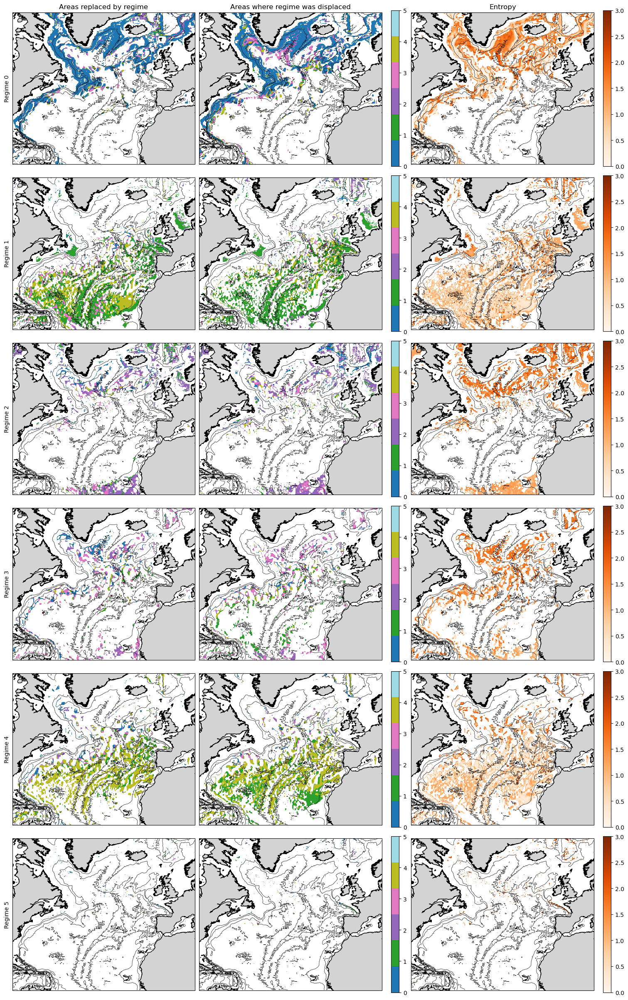

In [14]:
fig, axes = plt.subplots(num_clusters, 3, subplot_kw={'projection':ccrs.Miller()}, figsize=(15,24), constrained_layout=True)

for regime in range(num_clusters):
    plot_expanses(regime, row=regime)
        
for i in range(num_clusters):
    for j in range(3):
        xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(10,70)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)
    
axes[0,0].set_title('Areas replaced by regime')
axes[0,1].set_title('Areas where regime was displaced')
axes[0,2].set_title('Entropy')

for i in range(num_clusters):
    for j in range(3):
        axes[i,j].set_yticks([])
        axes[i,j].set_ylabel('')
    axes[i,0].set_ylabel(f'Regime {i}')

plt.savefig(f'figures/regime_shift/natlantic_regime_shift.png', dpi=600)
plt.show()

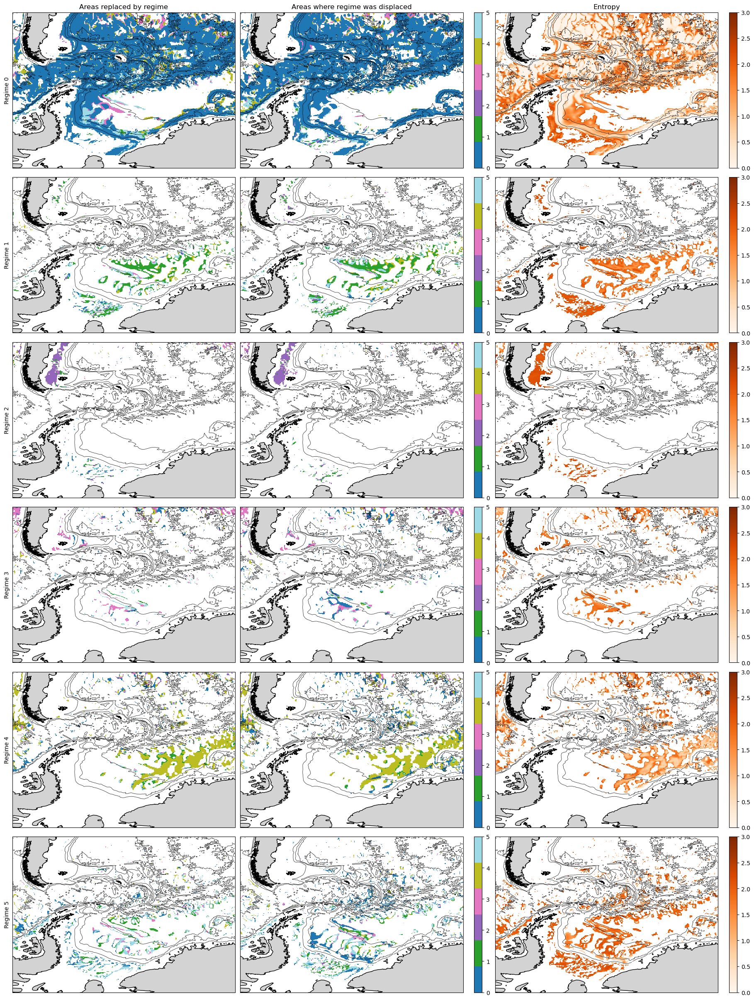

In [15]:
fig, axes = plt.subplots(num_clusters, 3, subplot_kw={'projection':ccrs.Miller()}, figsize=(18,24), constrained_layout=True)

for regime in range(num_clusters):
    plot_expanses_socean(regime, row=regime)
        
for i in range(num_clusters):
    for j in range(3):
        xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', linewidths=0.5)
    
axes[0,0].set_title('Areas replaced by regime')
axes[0,1].set_title('Areas where regime was displaced')
axes[0,2].set_title('Entropy')

for i in range(num_clusters):
    for j in range(3):
        axes[i,j].set_yticks([])
        axes[i,j].set_ylabel('')
    axes[i,0].set_ylabel(f'Regime {i}')

plt.savefig(f'figures/regime_shift/socean_regime_shift.png', dpi=600)
plt.show()

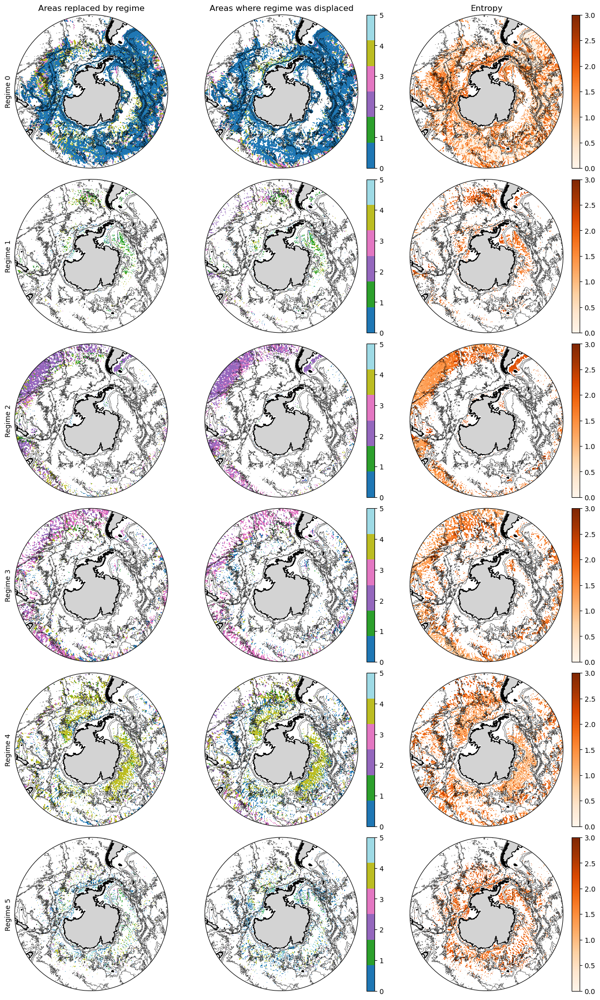

In [16]:
fig, axes = plt.subplots(num_clusters, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,20), constrained_layout=True)

for regime in range(num_clusters):
    plot_expanses_socean_full(regime, row=regime)
        
for i in range(num_clusters):
    for j in range(3):
        xr.plot.contour(col_height.sel(lat=slice(-90,-40)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', alpha=0.75, linewidths=0.5)

axes[0,0].set_title('Areas replaced by regime')
axes[0,1].set_title('Areas where regime was displaced')
axes[0,2].set_title('Entropy')

for i in range(num_clusters):
    for j in range(3):
        axes[i,j].set_yticks([])
        axes[i,j].set_ylabel('')
    axes[i,0].set_ylabel(f'Regime {i}')

plt.savefig(f'figures/regime_shift/socean_full_regime_shift.png', dpi=600)
plt.show()

In [29]:
def plot_regime_shift_natlantic(regime, row=regime):
    regime_control = xr.where(control_pred == regime, regime, np.nan)
    regime_scenario = xr.where(pred == regime, regime, np.nan)

    difference = xr.where((regime_control == regime) & (regime_scenario == regime), 0, np.nan)
    difference = xr.where((regime_scenario == regime) & np.isnan(regime_control), -1, difference)
    difference = xr.where((regime_control == regime) & np.isnan(regime_scenario), -2, difference)
    
    tf_colors = [[1.0, 0.6470588235294118, 0.0, 1.0],
                 [0.09019608, 0.74509804, 0.81176471, 1.]]
    regime_color = np.expand_dims(plt.get_cmap('tab20', num_clusters).colors[regime], axis=0)
    new_cmap = ListedColormap(np.append(tf_colors, regime_color, axis=0))

    to_plot = difference.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
    pcm = to_plot.plot(ax=axes[row,0], transform=ccrs.PlateCarree(), cmap=new_cmap,
                       vmin=-2, vmax=0, add_colorbar=False)
    my_cbar = fig.colorbar(pcm, ax=axes[row,0], ticks=[-2,-1,0])
    my_cbar.ax.set_yticklabels(['Replaced', 'Displaced', f'Regime {regime}'])

    entropy_masked = xr.where(~np.isnan(difference), entropy, np.nan)
    to_plot = entropy_masked.sel(lon=slice(-80,10)).sel(lat=slice(10,70))
    to_plot.plot(ax=axes[row,1], transform=ccrs.PlateCarree(), cmap='Oranges',
                 vmin=0, vmax=3)
    
    for i in range(2):
        axes[row,i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[row,i].coastlines(resolution='10m')
        
def plot_regime_shift_socean(regime, row=regime):
    regime_control = xr.where(control_pred == regime, regime, np.nan)
    regime_scenario = xr.where(pred == regime, regime, np.nan)

    difference = xr.where((regime_control == regime) & (regime_scenario == regime), 0, np.nan)
    difference = xr.where((regime_scenario == regime) & np.isnan(regime_control), -1, difference)
    difference = xr.where((regime_control == regime) & np.isnan(regime_scenario), -2, difference)
    
    tf_colors = [[1.0, 0.6470588235294118, 0.0, 1.0],
                 [0.09019608, 0.74509804, 0.81176471, 1.]]
    regime_color = np.expand_dims(plt.get_cmap('tab20', num_clusters).colors[regime], axis=0)
    new_cmap = ListedColormap(np.append(tf_colors, regime_color, axis=0))

    to_plot = difference.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40))
    pcm = to_plot.plot(ax=axes[row,0], transform=ccrs.PlateCarree(), cmap=new_cmap,
                       vmin=-2, vmax=0, add_colorbar=False)
    my_cbar = fig.colorbar(pcm, ax=axes[row,0], ticks=[-2,-1,0])
    my_cbar.ax.set_yticklabels(['Replaced', 'Displaced', f'Regime {regime}'])

    entropy_masked = xr.where(~np.isnan(difference), entropy, np.nan)
    to_plot = entropy_masked.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40))
    to_plot.plot(ax=axes[row,1], transform=ccrs.PlateCarree(), cmap='Oranges',
                 vmin=0, vmax=3)
    
    for i in range(2):
        axes[row,i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[row,i].coastlines(resolution='10m')

def plot_regime_shift_socean_full(regime, row=regime):
    regime_control = xr.where(control_pred == regime, regime, np.nan)
    regime_scenario = xr.where(pred == regime, regime, np.nan)

    difference = xr.where((regime_control == regime) & (regime_scenario == regime), 0, np.nan)
    difference = xr.where((regime_scenario == regime) & np.isnan(regime_control), -1, difference)
    difference = xr.where((regime_control == regime) & np.isnan(regime_scenario), -2, difference)
    
    tf_colors = [[1.0, 0.6470588235294118, 0.0, 1.0],
                 [0.09019608, 0.74509804, 0.81176471, 1.]]
    regime_color = np.expand_dims(plt.get_cmap('tab20', num_clusters).colors[regime], axis=0)
    new_cmap = ListedColormap(np.append(tf_colors, regime_color, axis=0))

    to_plot = difference.sel(lat=slice(-90,-40))
    pcm = to_plot.plot(ax=axes[row,0], transform=ccrs.PlateCarree(), cmap=new_cmap,
                       vmin=-2, vmax=0, add_colorbar=False)
    my_cbar = fig.colorbar(pcm, ax=axes[row,0], ticks=[-2,-1,0])
    my_cbar.ax.set_yticklabels(['Replaced', 'Displaced', f'Regime {regime}'])

    entropy_masked = xr.where(~np.isnan(difference), entropy, np.nan)
    to_plot = entropy_masked.sel(lat=slice(-90,-40))
    to_plot.plot(ax=axes[row,1], transform=ccrs.PlateCarree(), cmap='Oranges',
                 vmin=0, vmax=3)
    
    # Compute a circle in axes coordinates, which we can use as a boundary
    # for the map. We can pan/zoom as much as we like - the boundary will be
    # permanently circular.
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)
    
    for i in range(2):
        axes[row,i].add_feature(cfeature.LAND, facecolor='lightgrey')
        axes[row,i].coastlines(resolution='10m')
        axes[row,i].set_boundary(circle, transform=axes[row,i].transAxes)

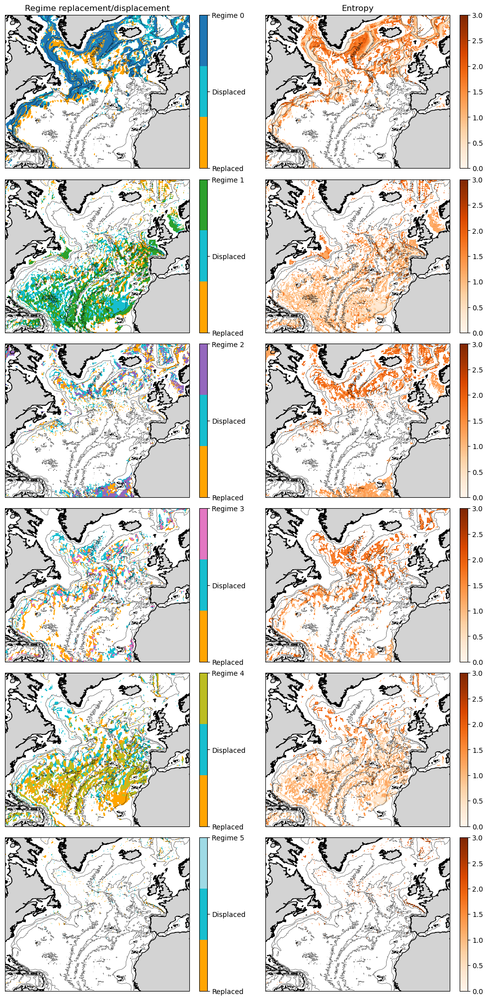

In [25]:
fig, axes = plt.subplots(num_clusters, 2, subplot_kw={'projection':ccrs.Miller(central_longitude=-90)}, figsize=(10,20), constrained_layout=True)

for regime in range(num_clusters):
    plot_regime_shift_natlantic(regime, row=regime)
    
for i in range(num_clusters):
    for j in range(2):
        xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(10,70)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', alpha=0.75, linewidths=0.5)

axes[0,0].set_title('Regime replacement/displacement')
axes[0,1].set_title('Entropy')

plt.savefig(f'figures/regime_shift/natlantic_regime_shift_concise.png', dpi=600)
plt.show()

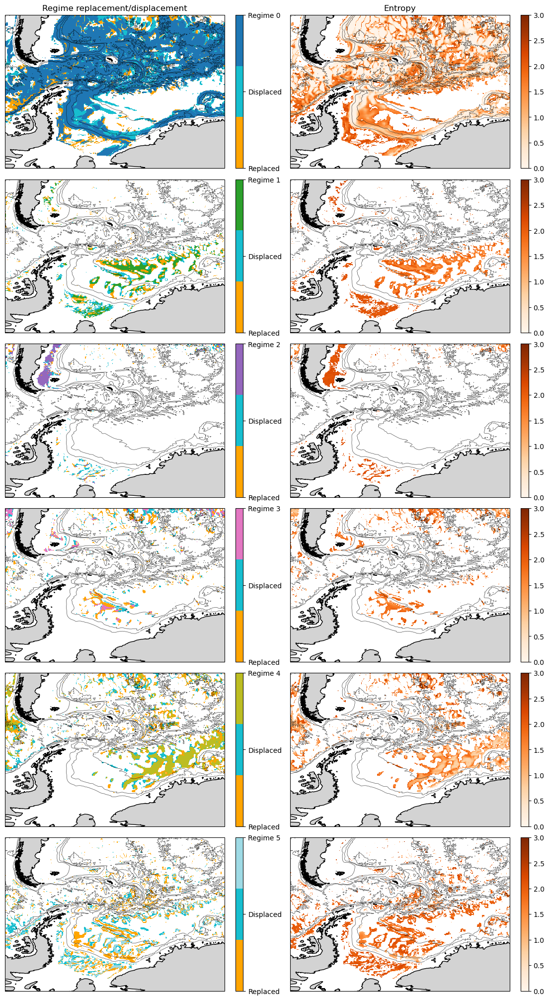

In [32]:
fig, axes = plt.subplots(num_clusters, 2, subplot_kw={'projection':ccrs.Miller(central_longitude=-90)}, figsize=(11,20), constrained_layout=True)

for regime in range(num_clusters):
    plot_regime_shift_socean(regime, row=regime)
    
for i in range(num_clusters):
    for j in range(2):
        xr.plot.contour(col_height.sel(lon=slice(-80,10)).sel(lat=slice(-80,-40)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', alpha=0.75, linewidths=0.5)

axes[0,0].set_title('Regime replacement/displacement')
axes[0,1].set_title('Entropy')

plt.savefig(f'figures/regime_shift/socean_regime_shift_concise.png', dpi=600)
plt.show()

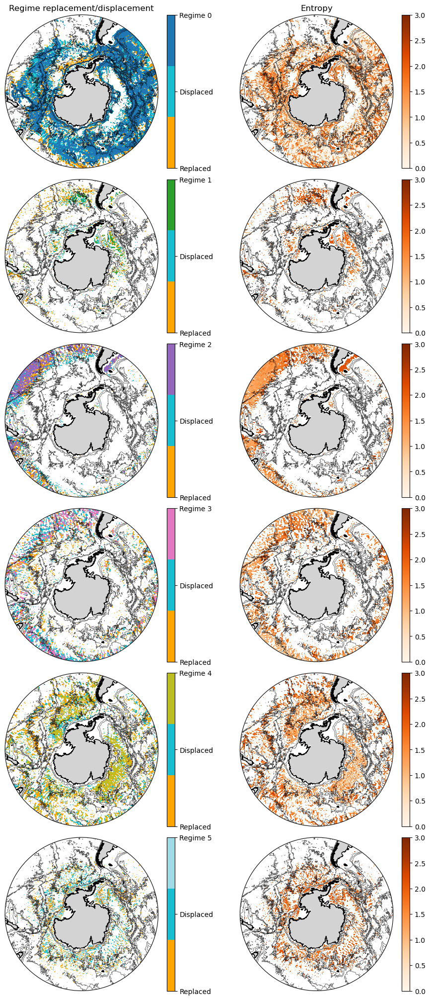

In [28]:
fig, axes = plt.subplots(num_clusters, 2, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(9,20), constrained_layout=True)

for regime in range(num_clusters):
    plot_regime_shift_socean_full(regime, row=regime)
    
for i in range(num_clusters):
    for j in range(2):
        xr.plot.contour(col_height.sel(lat=slice(-90,-40)), ax=axes[i,j],
                        transform=ccrs.PlateCarree(), colors='black', alpha=0.75, linewidths=0.5)

axes[0,0].set_title('Regime replacement/displacement')
axes[0,1].set_title('Entropy')

plt.savefig(f'figures/regime_shift/socean_full_regime_shift_concise.png', dpi=600)
plt.show()

## Entropy comparisons

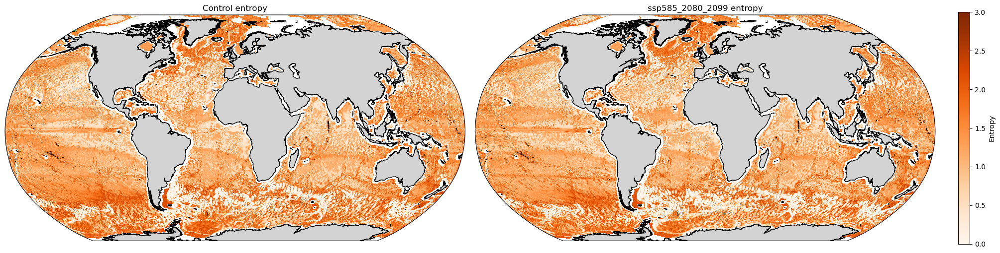

In [68]:
fig, axes = plt.subplots(1, 2, subplot_kw={'projection':ccrs.Robinson()}, figsize=(20,5), constrained_layout=True)

control_entropy.plot(ax=axes[0], transform=ccrs.PlateCarree(), cmap='Oranges',
                     vmin=0, vmax=3, add_colorbar=False)

entropy.plot(ax=axes[1], transform=ccrs.PlateCarree(), cmap='Oranges',
             vmin=0, vmax=3)

axes[0].set_title('Control entropy')
axes[1].set_title(f'{experiment} entropy')

for i in range(2):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')

plt.show()

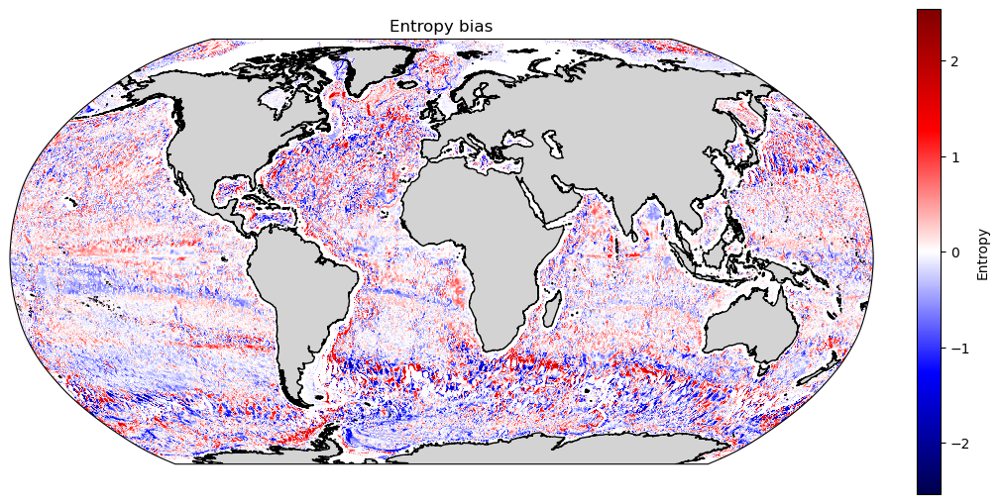

In [72]:
fig, axes = plt.subplots(1, 1, subplot_kw={'projection':ccrs.Robinson()}, figsize=(10,5), constrained_layout=True)

(entropy-control_entropy).plot(ax=axes, transform=ccrs.PlateCarree(), cmap='seismic')

axes.set_title('Entropy bias')
axes.add_feature(cfeature.LAND, facecolor='lightgrey')
axes.coastlines(resolution='10m')

plt.show()

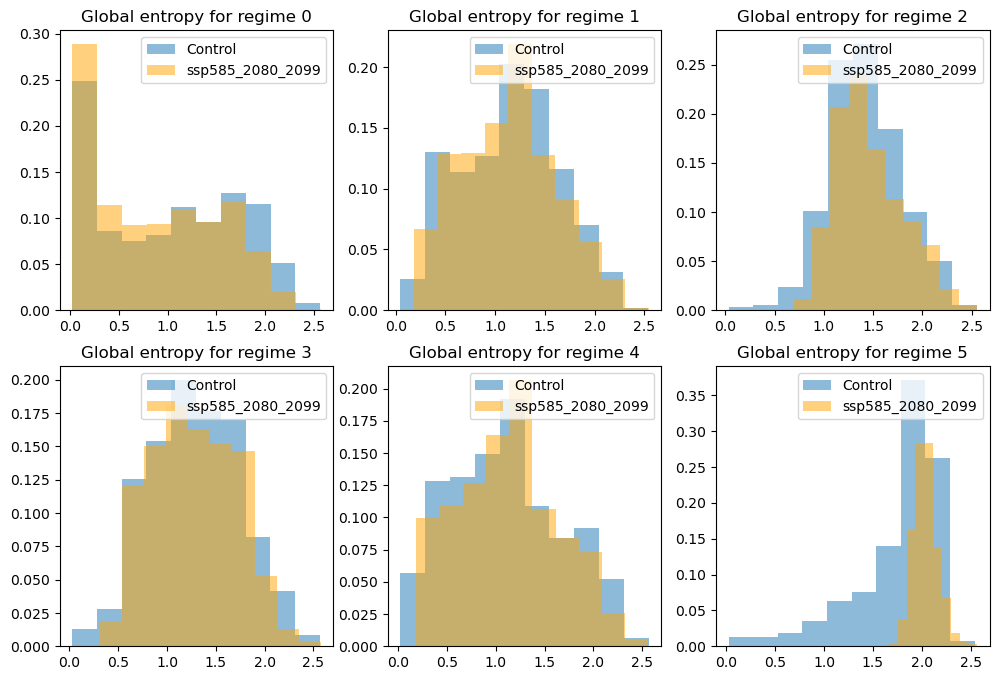

In [114]:
fig, axes = plt.subplots(2, 3, figsize=(12,8))

for i in range(num_clusters):
    
    entropy_by_regime = xr.where(pred == i, entropy, np.nan).data.flatten()
    entropy_by_regime = entropy_by_regime[~np.isnan(entropy_by_regime)]
    
    control_entropy_by_regime = xr.where(pred == i, control_entropy, np.nan).data.flatten()
    control_entropy_by_regime = control_entropy_by_regime[~np.isnan(control_entropy_by_regime)]
    
    axes[i//3,i%3].hist(control_entropy_by_regime, weights=(1/len(control_entropy_by_regime))*np.ones(len(control_entropy_by_regime)),
                        alpha=0.5, label='Control')
    axes[i//3,i%3].hist(entropy_by_regime, weights=(1/len(entropy_by_regime))*np.ones(len(entropy_by_regime)), color='orange',
                        alpha=0.5, label=experiment)
    axes[i//3,i%3].legend()
    
    axes[i//3,i%3].set_title(f'Global entropy for regime {i}')

plt.savefig(f'figures/global_entropy_by_regime_hist_{experiment}.png', dpi=600)
plt.show()

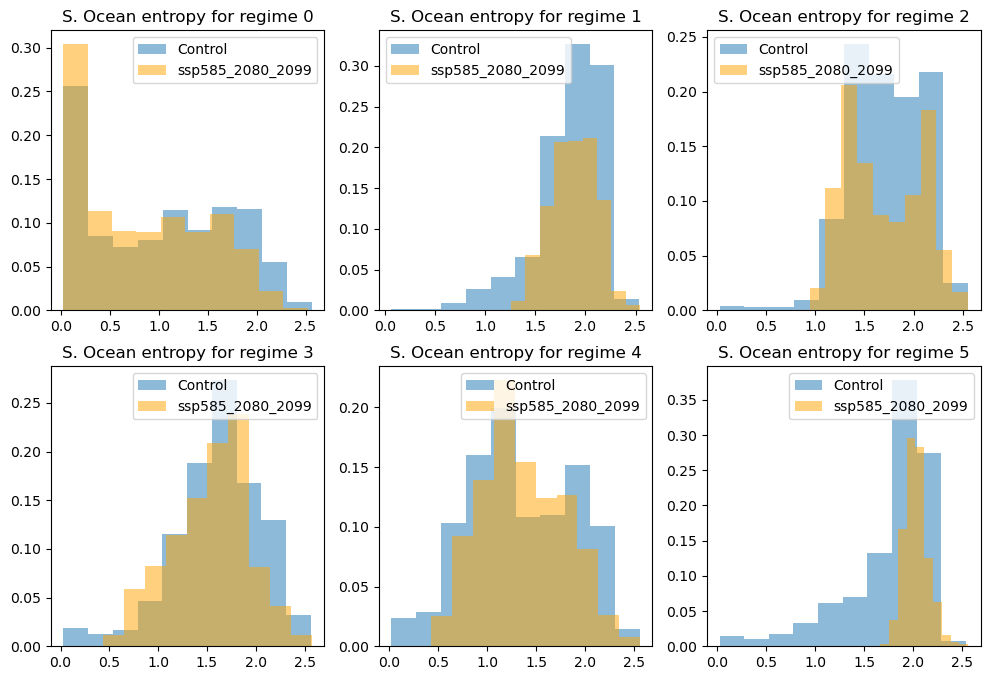

In [115]:
fig, axes = plt.subplots(2, 3, figsize=(12,8))

for i in range(num_clusters):
    
    entropy_by_regime = xr.where(pred == i, entropy, np.nan).sel(lat=slice(-90,-40)).data.flatten()
    entropy_by_regime = entropy_by_regime[~np.isnan(entropy_by_regime)]
    
    control_entropy_by_regime = xr.where(pred == i, control_entropy, np.nan).sel(lat=slice(-90,-40)).data.flatten()
    control_entropy_by_regime = control_entropy_by_regime[~np.isnan(control_entropy_by_regime)]
    
    axes[i//3,i%3].hist(control_entropy_by_regime, weights=(1/len(control_entropy_by_regime))*np.ones(len(control_entropy_by_regime)),
                        alpha=0.5, label='Control')
    axes[i//3,i%3].hist(entropy_by_regime, weights=(1/len(entropy_by_regime))*np.ones(len(entropy_by_regime)), color='orange',
                        alpha=0.5, label=experiment)
    axes[i//3,i%3].legend()
    
    axes[i//3,i%3].set_title(f'S. Ocean entropy for regime {i}')
    
plt.savefig(f'figures/socean_entropy_by_regime_hist_{experiment}.png', dpi=600)
plt.show()

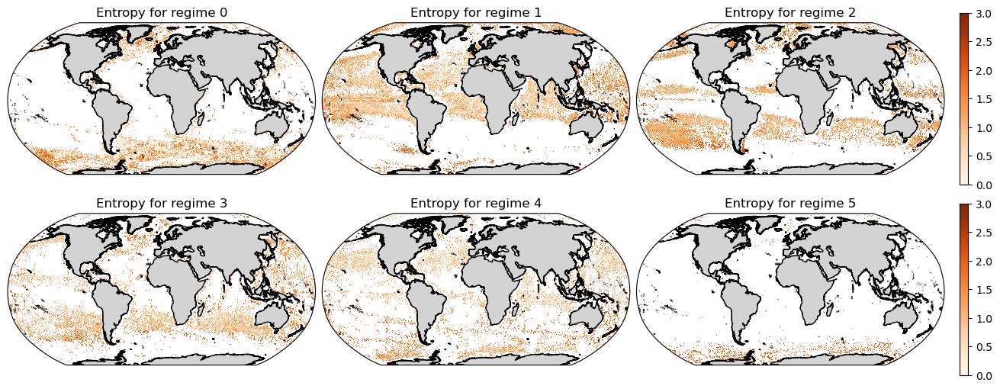

In [116]:
fig, axes = plt.subplots(2, 3, subplot_kw={'projection':ccrs.Robinson()}, figsize=(13,5), constrained_layout=True)

for i in range(num_clusters):
    
    entropy_by_regime = xr.where(pred == i, entropy, np.nan)
    
    add_cbar = False
    if i % 3 == 2:
        add_cbar = True
        
    entropy_by_regime.plot(ax=axes[i//3,i%3], transform=ccrs.PlateCarree(), cmap='Oranges', vmin=0, vmax=3, add_colorbar=add_cbar)
    
    axes[i//3,i%3].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i//3,i%3].coastlines(resolution='10m')
    axes[i//3,i%3].set_title(f'Entropy for regime {i}')
    
plt.savefig(f'figures/global_entropy_by_regime_{experiment}.png', dpi=600)
plt.show()

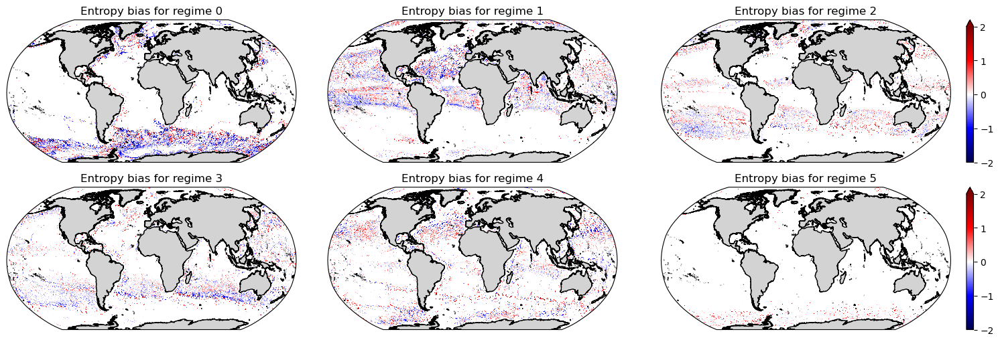

In [117]:
entropy_bias = entropy - control_entropy

fig, axes = plt.subplots(2, 3, subplot_kw={'projection':ccrs.Robinson()}, figsize=(15,5), constrained_layout=True)

for i in range(num_clusters):
    
    bias_by_regime = xr.where(pred == i, entropy_bias, np.nan)
    
    add_cbar = False
    if i % 3 == 2:
        add_cbar = True
        
    bias_by_regime.plot(ax=axes[i//3,i%3], transform=ccrs.PlateCarree(), cmap='seismic', vmin=-2, vmax=2, add_colorbar=add_cbar)
    
    axes[i//3,i%3].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i//3,i%3].coastlines(resolution='10m')
    axes[i//3,i%3].set_title(f'Entropy bias for regime {i}')

plt.savefig(f'figures/global_entropy_bias_by_regime_{experiment}.png', dpi=600)
plt.show()

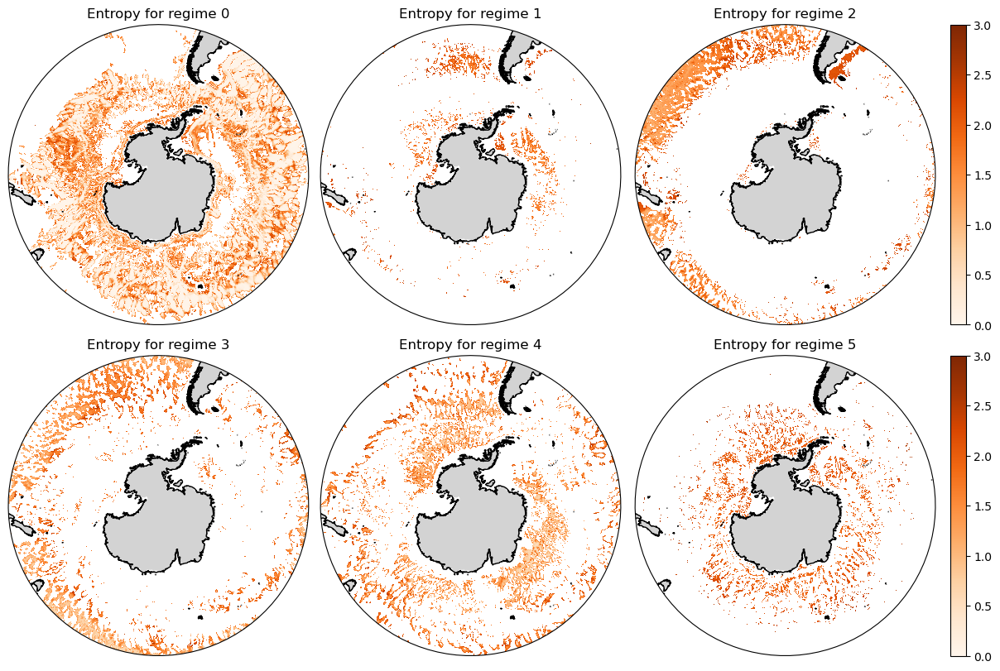

In [118]:
fig, axes = plt.subplots(2, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,8), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

for i in range(num_clusters):
    
    entropy_by_regime = xr.where(pred == i, entropy, np.nan).sel(lat=slice(-90,-40))
    
    add_cbar = False
    if i % 3 == 2:
        add_cbar = True
        
    entropy_by_regime.plot(ax=axes[i//3,i%3], transform=ccrs.PlateCarree(), cmap='Oranges', vmin=0, vmax=3, add_colorbar=add_cbar)
    
    axes[i//3,i%3].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i//3,i%3].coastlines(resolution='10m')
    axes[i//3,i%3].set_boundary(circle, transform=axes[i//3,i%3].transAxes)
    axes[i//3,i%3].set_title(f'Entropy for regime {i}')
    
plt.savefig(f'figures/socean_entropy_by_regime_{experiment}.png', dpi=600)
plt.show()

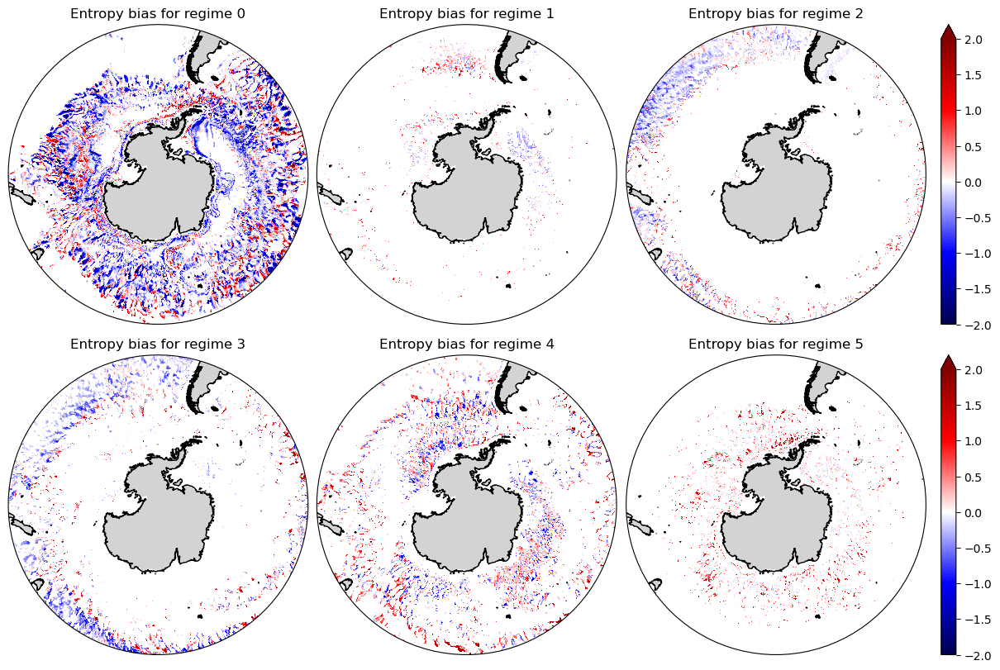

In [119]:
entropy_bias = entropy - control_entropy

fig, axes = plt.subplots(2, 3, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(12,8), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

for i in range(num_clusters):
    
    bias_by_regime = xr.where(pred == i, entropy_bias, np.nan).sel(lat=slice(-90,-40))
    
    add_cbar = False
    if i % 3 == 2:
        add_cbar = True
        
    bias_by_regime.plot(ax=axes[i//3,i%3], transform=ccrs.PlateCarree(), cmap='seismic', vmin=-2, vmax=2, add_colorbar=add_cbar)
    
    axes[i//3,i%3].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i//3,i%3].coastlines(resolution='10m')
    axes[i//3,i%3].set_boundary(circle, transform=axes[i//3,i%3].transAxes)
    axes[i//3,i%3].set_title(f'Entropy bias for regime {i}')

plt.savefig(f'figures/socean_entropy_bias_by_regime_{experiment}.png', dpi=600)
plt.show()

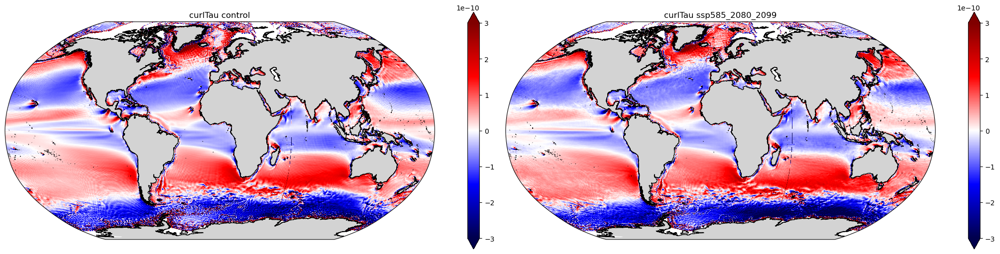

In [122]:
curlTau_control = xr.open_dataset(f'Data_Step2/control/curlTau.nc')['Curl_taus'].rename({'yq':'lat', 'xq':'lon'})
curlTau_scenario = xr.open_dataset(f'Data_Step2/{experiment}/curlTau.nc')['Curl_taus'].rename({'yq':'lat', 'xq':'lon'})

fig, axes = plt.subplots(1, 2, subplot_kw={'projection':ccrs.Robinson()}, figsize=(20,5), constrained_layout=True)

curlTau_control.plot(ax=axes[0], transform=ccrs.PlateCarree(), vmin=-3e-10, vmax=3e-10, cmap='seismic', cbar_kwargs={'label':''})
curlTau_scenario.plot(ax=axes[1], transform=ccrs.PlateCarree(), vmin=-3e-10, vmax=3e-10, cmap='seismic', cbar_kwargs={'label':''})

axes[0].set_title('curlTau control')
axes[1].set_title(f'curlTau {experiment}')

for i in range(2):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    
plt.savefig(f'figures/global_curlTau_comparison.png', dpi=600)
plt.show()

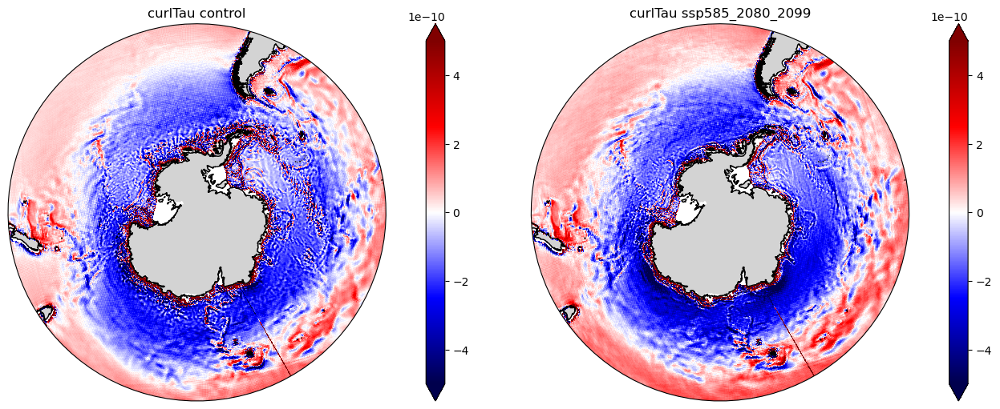

In [123]:
fig, axes = plt.subplots(1, 2, subplot_kw={'projection':ccrs.SouthPolarStereo(central_longitude=-90)}, figsize=(13,5), constrained_layout=True)

# Compute a circle in axes coordinates, which we can use as a boundary
# for the map. We can pan/zoom as much as we like - the boundary will be
# permanently circular.
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

curlTau_control.sel(lat=slice(-90,-40)).plot(ax=axes[0], transform=ccrs.PlateCarree(), vmin=-5e-10, vmax=5e-10, cmap='seismic', cbar_kwargs={'label':''})
curlTau_scenario.sel(lat=slice(-90,-40)).plot(ax=axes[1], transform=ccrs.PlateCarree(), vmin=-5e-10, vmax=5e-10, cmap='seismic', cbar_kwargs={'label':''})

axes[0].set_title('curlTau control')
axes[1].set_title(f'curlTau {experiment}')

for i in range(2):
    axes[i].add_feature(cfeature.LAND, facecolor='lightgrey')
    axes[i].coastlines(resolution='10m')
    axes[i].set_boundary(circle, transform=axes[i].transAxes)
    
plt.savefig(f'figures/socean_curlTau_comparison.png', dpi=600)
plt.show()